In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import image as mp_image

%matplotlib inline

from sklearn import metrics
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.model_selection import train_test_split

import os
import shutil

In [2]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision.datasets import ImageFolder

In [3]:
training_folder = 'Dataset/'

img_size = (128,128)

classes = sorted(os.listdir(training_folder))
print(classes)

['Cat', 'Dog', 'Lion', 'Tiger']


In [40]:
def load_dataset(data_dir):
    dataset = ImageFolder(data_dir,
                        transform=transforms.Compose([
                            transforms.Resize((150,150)),
                            transforms.ToTensor(),
                        ]))
    
    train_size = int(len(dataset) * 0.7)
    test_size = len(dataset) - train_size

    train_dataset, test_dataset = torch.utils.data.random_split(dataset, [train_size, test_size])

    train_loader = torch.utils.data.DataLoader(
        train_dataset,
        batch_size=128,
        num_workers=0,
        shuffle=False
    )

    test_loader = torch.utils.data.DataLoader(
        test_dataset,
        batch_size = 128,
        num_workers = 0,
        shuffle = False
    )

    return train_loader, test_loader


In [41]:
train_loader, test_loader = load_dataset(training_folder)
batch_size = train_loader.batch_size


In [42]:
from torch.utils.data.dataloader import DataLoader
from torch.utils.data import random_split

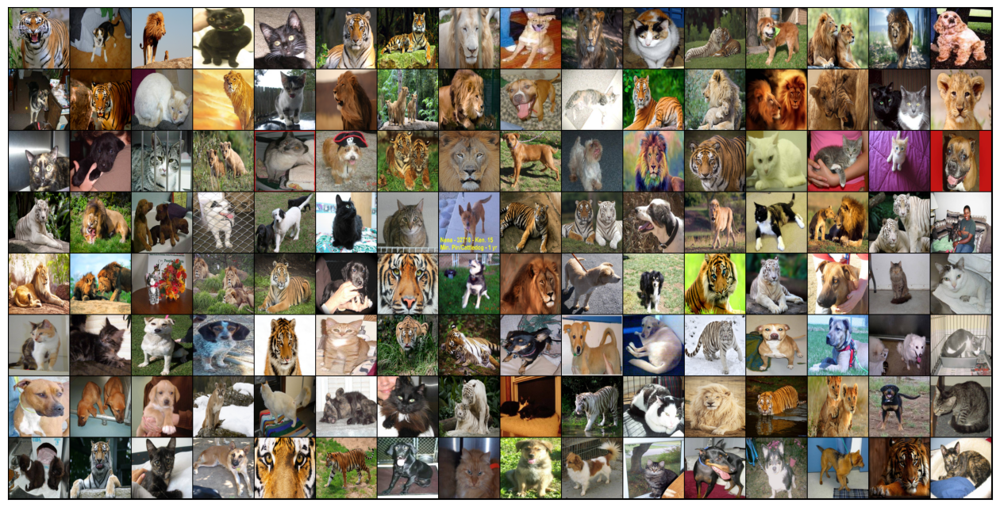

In [43]:
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

def show_batch(dl):
    """Plot images grid of single batch"""
    for images, labels in dl:
        fig,ax = plt.subplots(figsize = (16,12))
        ax.set_xticks([])
        ax.set_yticks([])
        ax.imshow(make_grid(images,nrow=16).permute(1,2,0))
        break
        
show_batch(train_loader)

In [44]:
for folder in os.listdir('Dataset/'):
    list_path = 'Dataset/' + folder
    print(f'Number of images in {folder} is {len(os.listdir(list_path))}')

Number of images in Cat is 190
Number of images in Dog is 192
Number of images in Lion is 182
Number of images in Tiger is 190


In [117]:
# create model architecture
class CNN_Net(nn.Module):
    def __init__(self, is_print_toggle = False):
        super(CNN_Net, self).__init__()
        
        ##----------------------------------------convolution layers---------------------------------------
        
        ## 1st convolution - max_pooling block  ==> # np.floor((imahe_height + 2*padding - kernel_size)/stride) + 1
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=12, kernel_size=3, stride=1, padding=1) 
        # shape = (256, 12, 150, 150)
        self.bn1 = nn.BatchNorm2d(num_features=12)                                                 
        # shape = (256, 12, 150, 150)
        self.relu1     = nn.ReLU()                                                                 
        # shape = (256, 12, 150, 150)
        self.max_pool1 = nn.MaxPool2d(kernel_size = 2)                                             
        # So, after maxpool, 148/2 = 74 # shape = (256, 12, 75, 75)
        
        
        
        ## 2nd convolution - max_pooling block
        self.conv2 = nn.Conv2d(in_channels=12,out_channels=20,kernel_size=3,stride=1,padding=1) 
        # shape = (256, 20, 75, 75)        
        self.relu2 = nn.ReLU()  
        # shape = (256, 20, 75, 75)
        
        
        
        ## convolution layer 3
        self.conv3 = nn.Conv2d(in_channels=20, out_channels=32,kernel_size=3,stride=1,padding=1)
        # shape = (256, 32, 75, 75)
        self.bn3 = nn.BatchNorm2d(num_features=32)
        # shape = (256, 32, 75, 75)
        self.relu3     = nn.ReLU()
        # shape = (256, 32, 75, 75)
        
        
        
        ##----------------------------------------------FCL---------------------------------------------------
        estimated_features = 32 * 75 * 75 # output_channel * height * width = 180000 (from convolution layer 3)
        
        # output layer
        self.output = nn.Linear(in_features = estimated_features, out_features = 4)
        
        self.print_toggle = is_print_toggle
        
        
        
        
    def forward(self, X):
        
        ##----------------------------------------convolution layers---------------------------------------
        print(f"Input: {X.shape}") if self.print_toggle else None
        
        # 1st convolution-maxpooling block
        convolution_layer1 = self.relu1( self.bn1( self.conv1(X) ) )
        X = self.max_pool1( convolution_layer1 )
        print(f"conv1/max_pool: {X.shape}") if self.print_toggle else None
        
        # 2nd convolution-maxpooling block
        convolution_layer2 = self.relu2( self.conv2( X ) )
        print(f"Layer conv2/max_pool: {X.shape}") if self.print_toggle else None
        
        # 3rd convolution-maxpooling block
        X = self.relu3( self.bn3( self.conv3( convolution_layer2 ) ) )
        print(f"Layer conv3/max_pool: {X.shape}") if self.print_toggle else None
        
        
        ##----------------------------------------------FCL---------------------------------------------------
        # reshape for linear layers
        nUnits = X.shape.numel()/X.shape[0]
        X = X.view(-1, int(nUnits))  # this shape should to be (256, 32 * 75 * 75) = (256, 180000)
        if self.print_toggle: print(f"Vectorize: {X.shape}")
        
        # Output layer
        X = self.output(X)
        if self.print_toggle: print(f"Layer output: {X.shape}")
        
        return X, convolution_layer1, convolution_layer2

In [118]:
def create_network(is_print_toggle, learning_rate=0.001):
    # create a model instance
    network = CNN_Net(is_print_toggle)
    
    # select loss function
    loss_fun = nn.CrossEntropyLoss()
    
    # select optimizer
    optimizer = torch.optim.Adam(network.parameters(), lr=learning_rate, weight_decay=0.0001)
    
    return network, loss_fun, optimizer

In [119]:
network, loss_fun, optimizer = create_network(is_print_toggle=True)

X, y = next(iter(train_loader))
yHat = network(X)[0]  # here, we don't need the convolution layers' outputs

# check sizes of model outputs and target variable
print(' ')
print(yHat.shape)
print(y.shape)

# now let's compute the loss
loss = loss_fun(yHat, y)
print(' ')
print('Loss:')
print(loss)

Input: torch.Size([128, 3, 150, 150])
conv1/max_pool: torch.Size([128, 12, 75, 75])
Layer conv2/max_pool: torch.Size([128, 12, 75, 75])
Layer conv3/max_pool: torch.Size([128, 32, 75, 75])
Vectorize: torch.Size([128, 180000])
Layer output: torch.Size([128, 6])
 
torch.Size([128, 6])
torch.Size([128])
 
Loss:
tensor(1.9195, grad_fn=<NllLossBackward0>)


In [78]:
from torchsummary import summary

In [79]:
# summary of the model
network, loss_fun, optimizer = create_network(is_print_toggle = False)

if device == "cpu":
    summary(network.to(device), (3, 150, 150), device=device);
else:
    summary(network.to(device), (3, 150, 150));

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 12, 150, 150]             336
       BatchNorm2d-2         [-1, 12, 150, 150]              24
              ReLU-3         [-1, 12, 150, 150]               0
         MaxPool2d-4           [-1, 12, 75, 75]               0
            Conv2d-5           [-1, 20, 75, 75]           2,180
              ReLU-6           [-1, 20, 75, 75]               0
            Conv2d-7           [-1, 32, 75, 75]           5,792
       BatchNorm2d-8           [-1, 32, 75, 75]              64
              ReLU-9           [-1, 32, 75, 75]               0
           Linear-10                    [-1, 6]       1,080,006
Total params: 1,088,402
Trainable params: 1,088,402
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.26
Forward/backward pass size (MB): 12.53
Params size (MB): 4.15
Estima

In [81]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

In [82]:
def train_the_model(network, loss_fun, optimizer, epochs = 100):
    # number of epochs
    epochs = epochs
    
    # send the model to GPU'
    network.to(device)
    
    # initialize losses
    train_loss     = torch.zeros(epochs)
    test_loss      = torch.zeros(epochs)
    train_accuracy = []
    test_accuracy  = []
    
    # loop over epochs
    for epoch in range(epochs):
        # To calcuate the execution time,
        start_time = time.time()
        
        # switch on the training mode
        network.train()
        
        batch_accuracy = []
        batch_loss     = []
        # loop over the training data batches
        for X, y in train_loader:
            # push X and y to GPU
            X = X.to(device)
            y = y.to(device)
            
            # forward propagation
            yHat = network(X)[0]  # here, we dont need the convolution layers' outputs
            
            # compute loss
            loss = loss_fun(yHat, y)
            
            # backward propagation
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # store the loss from this batch
            batch_loss.append(loss.item())
            
            # compute accuracy
            accuracy_percentage = accuracy_score(y.detach().cpu(), torch.argmax(yHat, axis=1).detach().cpu()) * 100
            batch_accuracy.append( accuracy_percentage )
        # end of batch loop
        
        # now that we've trained through the batches, get their average train accuracy
        train_acc = np.mean(batch_accuracy)
        train_accuracy.append( train_acc ) 
        
        # and get average losses across the batches
        train_loss[epoch] = np.mean( batch_loss )
        
        # switch to evaluation mode to calculate test accuracy
        network.eval()
        
        # # extract X,y from test dataloader
        # X, y = next(iter(test_loader))
        
        temp_test_loss = []  # to store loss temporarily
        temp_test_acc  = []  # to store accuracy temporarily
        # loop through the test batches
        for X, y in test_loader:      
            # push the data to GPU
            X = X.to(device)
            y = y.to(device)
        
            with torch.no_grad():  # deactivate autograd
                # calculate prediction
                yHat = network(X)[0]  # here, we dont need the convolution layers' outputs
                # calculate loss
                loss = loss_fun(yHat, y)
                # and store it
                temp_test_loss.append(loss.item())
                
                # calculate accuracy and store it
                accuracy_percentage = accuracy_score(y.detach().cpu(), torch.argmax(yHat, axis=1).detach().cpu()) * 100
                temp_test_acc.append( accuracy_percentage )
        
        # calculate overall test loss and store it
        test_loss[epoch] = np.mean(temp_test_loss)
            
        # calculate the test accuracy
        test_acc = np.mean(temp_test_acc)
        test_accuracy.append(test_acc)
        
        # calculate end time
        end_time = time.time()
        
        # display a status message
        msg = f"Completed: {epoch + 1}/{epochs} - took: {(end_time - start_time):.6f} sec - Train accuracy: {train_acc:.5f} - Test accuracy: {test_acc:.5f}"
        sys.stdout.write("\n" + msg)
        
        
    # end epochs
    
    # function output
    return train_loss, test_loss, train_accuracy, test_accuracy, network

In [87]:
import time
import sys

In [88]:
%%time
# create a neural network
network, loss_fun, optimizer = create_network(is_print_toggle = False)
# train the model
train_loss, test_loss, train_accuracy, test_accuracy, network = train_the_model(network, loss_fun, optimizer, epochs = 10)


Completed: 1/10 - took: 19.963501 sec - Train accuracy: 27.70089 - Test accuracy: 42.37085
Completed: 2/10 - took: 20.470584 sec - Train accuracy: 51.76339 - Test accuracy: 24.47385
Completed: 3/10 - took: 21.263972 sec - Train accuracy: 61.04911 - Test accuracy: 25.37468
Completed: 4/10 - took: 20.756637 sec - Train accuracy: 73.72768 - Test accuracy: 25.37468
Completed: 5/10 - took: 20.578292 sec - Train accuracy: 76.71875 - Test accuracy: 25.88489
Completed: 6/10 - took: 21.224795 sec - Train accuracy: 80.15625 - Test accuracy: 25.37468
Completed: 7/10 - took: 20.914218 sec - Train accuracy: 84.53125 - Test accuracy: 26.15593
Completed: 8/10 - took: 21.201339 sec - Train accuracy: 89.53125 - Test accuracy: 34.29528
Completed: 9/10 - took: 21.463102 sec - Train accuracy: 95.75893 - Test accuracy: 41.50191
Completed: 10/10 - took: 20.395264 sec - Train accuracy: 97.96875 - Test accuracy: 53.87436CPU times: total: 8min
Wall time: 3min 28s


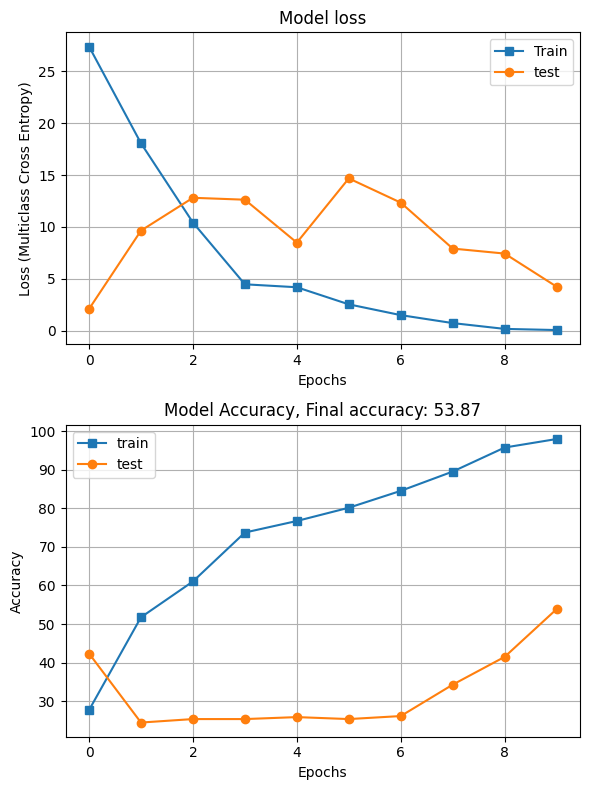

In [92]:
# display the accuracy of our model
fig, ax = plt.subplots(2, 1, figsize = (6, 8))

ax[0].plot(train_loss, "s-", label = "Train")
ax[0].plot(test_loss, "o-", label = "test")
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Loss (Multiclass Cross Entropy)")
ax[0].set_title("Model loss")
ax[0].legend()
ax[0].grid()

ax[1].plot(train_accuracy, "s-", label = "train")
ax[1].plot(test_accuracy, "o-", label = "test")
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Accuracy")
ax[1].set_title(f"Model Accuracy, Final accuracy: {test_accuracy[-1]:.2f}")
ax[1].legend()
ax[1].grid()


plt.tight_layout()
plt.show()

In [90]:
### mow let's look though the convolution channels ###

# extract a bact from the test set
X, y = next(iter(test_loader))

# move the data to GPU
X = X.to(device)
y = y.to(device)

# prediction and out convolution layers
yHat, feature_maps1, feature_maps2= network(X)
# check the shape of the two feature maps
print(feature_maps1.shape, feature_maps2.shape)

torch.Size([128, 12, 150, 150]) torch.Size([128, 20, 75, 75])


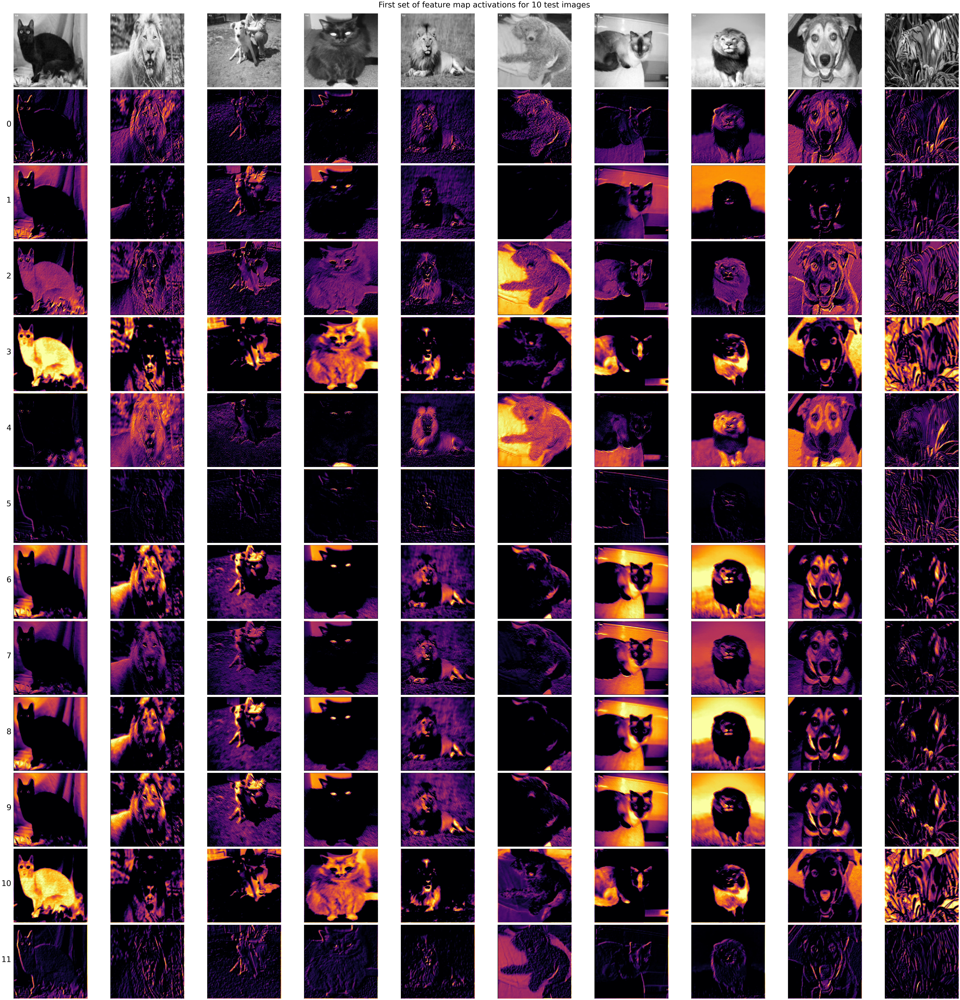

In [93]:
number_of_images = 10

fig,axs = plt.subplots(feature_maps1.shape[1] + 1, number_of_images, figsize=(70, 70))

for pici in range(number_of_images):

    # show the original picture
    img = X[pici, 0, :, :].detach().cpu()
    axs[0, pici].imshow(img, cmap="gray", vmin=0, vmax=1)
    axs[0, pici].axis('off')
    axs[0, pici].text(2,2,'T:%s'%int(y[pici].item()),ha='left',va='top',color='w',fontweight='bold')

    for feati in range(feature_maps1.shape[1]):
        # extract the feature map from this image
        img = feature_maps1[pici,feati,:,:].detach().cpu()
        axs[feati+1,pici].imshow(img,cmap='inferno',vmin=0,vmax=torch.max(img)*.9)
        axs[feati+1,pici].axis('off')
        axs[feati+1,pici].text(-5,feature_maps1.shape[2]/2,feati,ha='right', fontsize=40) if pici==0 else None

plt.tight_layout()
plt.suptitle(f'First set of feature map activations for {number_of_images} test images',x=.5,y=1.01, fontsize=40)

# save the plot
# plt.savefig('feature_maps1.png', dpi=300, bbox_inches='tight')
plt.show()

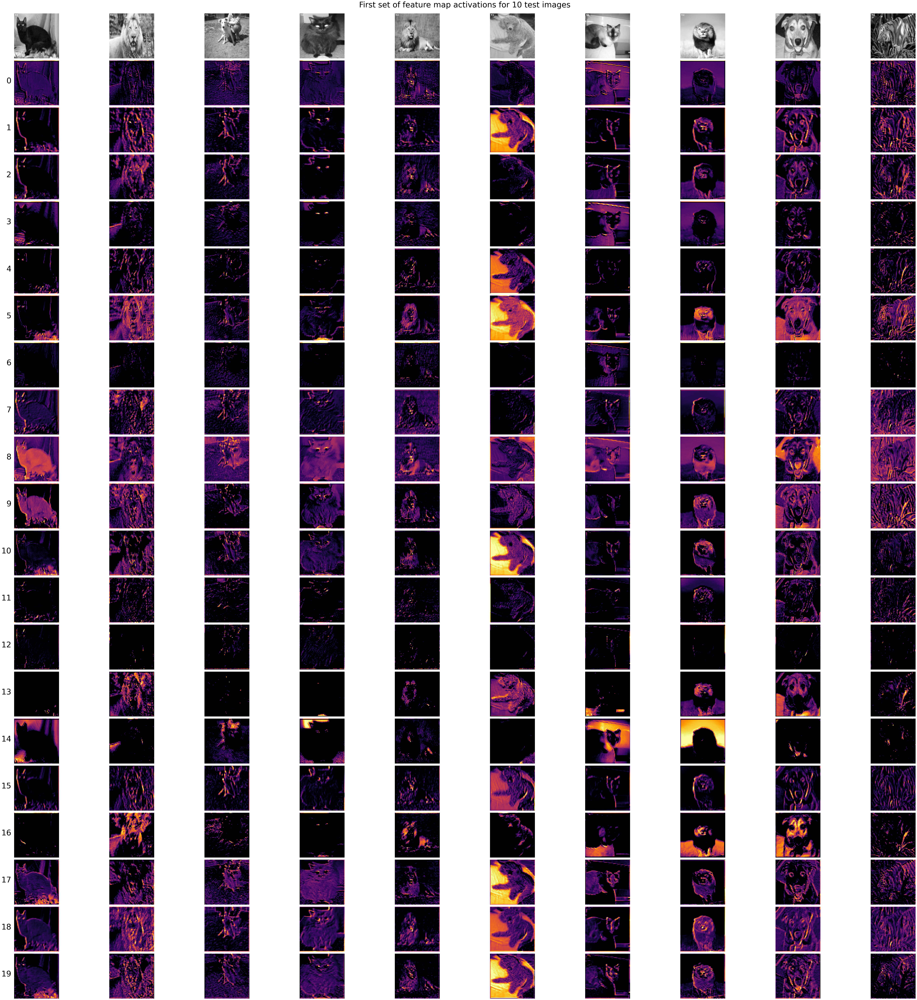

In [94]:
# Feature maps from the convolution layer 2

number_of_images = 10

fig,axs = plt.subplots(feature_maps2.shape[1] + 1, number_of_images, figsize=(70, 70))

for pici in range(number_of_images):

    # show the original picture
    img = X[pici, 0, :, :].detach().cpu()
    axs[0, pici].imshow(img, cmap="gray", vmin=0, vmax=1)
    axs[0, pici].axis('off')
    axs[0, pici].text(2,2,'T:%s'%int(y[pici].item()),ha='left',va='top',color='w',fontweight='bold')

    for feati in range(feature_maps2.shape[1]):
        # extract the feature map from this image
        img = feature_maps2[pici,feati,:,:].detach().cpu()
        axs[feati+1,pici].imshow(img,cmap='inferno',vmin=0,vmax=torch.max(img)*.9)
        axs[feati+1,pici].axis('off')
        axs[feati+1,pici].text(-5,feature_maps2.shape[2]/2,feati,ha='right', fontsize=40) if pici==0 else None

plt.tight_layout()
plt.suptitle(f'First set of feature map activations for {number_of_images} test images',x=.5,y=1.01, fontsize=40)

# save the plot
# plt.savefig('feature_maps2.png', dpi=300, bbox_inches='tight')
plt.show()

In [120]:
import torch.nn.functional as F

class CNN_Net(nn.Module):
    def __init__(self, is_print_toggle=False):
        super(CNN_Net, self).__init__()

        ##----------------------------------------convolution layers---------------------------------------
        
        ## 1st convolution - max_pooling block  ==> # np.floor((imahe_height + 2*padding - kernel_size)/stride) + 1
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=12, kernel_size=3, stride=1, padding=1) 
        # shape = (256, 12, 150, 150)
        self.bn1 = nn.BatchNorm2d(num_features=12)                                                 
        # shape = (256, 12, 150, 150)
        self.relu1 = nn.ReLU()                                                                 
        # shape = (256, 12, 150, 150)
        self.max_pool1 = nn.MaxPool2d(kernel_size=2)                                             
        # So, after maxpool, 148/2 = 74 # shape = (256, 12, 75, 75)
        
        ## 2nd convolution - max_pooling block
        self.conv2 = nn.Conv2d(in_channels=12, out_channels=20, kernel_size=3, stride=1, padding=1) 
        # shape = (256, 20, 75, 75)        
        self.relu2 = nn.ReLU()  
        # shape = (256, 20, 75, 75)
        
        ## convolution layer 3
        self.conv3 = nn.Conv2d(in_channels=20, out_channels=32, kernel_size=3, stride=1, padding=1)
        # shape = (256, 32, 75, 75)
        self.bn3 = nn.BatchNorm2d(num_features=32)
        # shape = (256, 32, 75, 75)
        self.relu3 = nn.ReLU()
        # shape = (256, 32, 75, 75)
        
        ##----------------------------------------------GAP---------------------------------------------------
        # Global Average Pooling
        self.global_avg_pool = nn.AdaptiveAvgPool2d((1, 1))  # Output size will be (1, 1)
        
        # output layer
        self.output = nn.Linear(in_features=32, out_features=4)  # Input features reduced to 32 by GAP
        
        self.print_toggle = is_print_toggle

    def forward(self, X):
        ##----------------------------------------convolution layers---------------------------------------
        print(f"Input: {X.shape}") if self.print_toggle else None
        
        # 1st convolution-maxpooling block
        convolution_layer1 = self.relu1(self.bn1(self.conv1(X)))
        X = self.max_pool1(convolution_layer1)
        print(f"conv1/max_pool: {X.shape}") if self.print_toggle else None
        
        # 2nd convolution-maxpooling block
        convolution_layer2 = self.relu2(self.conv2(X))
        print(f"Layer conv2/max_pool: {X.shape}") if self.print_toggle else None
        
        # 3rd convolution-maxpooling block
        X = self.relu3(self.bn3(self.conv3(convolution_layer2)))
        print(f"Layer conv3/max_pool: {X.shape}") if self.print_toggle else None
        
        ##----------------------------------------------GAP---------------------------------------------------
        # Global Average Pooling
        X = self.global_avg_pool(X)
        if self.print_toggle:
            print(f"Global Avg Pool: {X.shape}")
        
        # Reshape for linear layer
        X = torch.flatten(X, 1)  # Flatten the feature maps
        
        # Output layer
        X = self.output(X)
        if self.print_toggle:
            print(f"Layer output: {X.shape}")
        
        return X, convolution_layer1, convolution_layer2

In [121]:
# create neural network
def create_network(is_print_toggle, learning_rate=0.001):
    # create a model instance
    network = CNN_Net(is_print_toggle)
    
    # select loss function
    loss_fun = nn.CrossEntropyLoss()
    
    # select optimizer
    optimizer = torch.optim.Adam(network.parameters(), lr=learning_rate, weight_decay=0.0001)
    
    return network, loss_fun, optimizer

In [122]:
# test the model with one batch (sanity check)
network, loss_fun, optimizer = create_network(is_print_toggle=True)

X, y = next(iter(train_loader))
yHat = network(X)[0]  # here, we don't need the convolution layers' outputs

# check sizes of model outputs and target variable
print(' ')
print(yHat.shape)
print(y.shape)

# now let's compute the loss
loss = loss_fun(yHat, y)
print(' ')
print('Loss:')
print(loss)


Input: torch.Size([128, 3, 150, 150])
conv1/max_pool: torch.Size([128, 12, 75, 75])
Layer conv2/max_pool: torch.Size([128, 12, 75, 75])
Layer conv3/max_pool: torch.Size([128, 32, 75, 75])
Global Avg Pool: torch.Size([128, 32, 1, 1])
Layer output: torch.Size([128, 6])
 
torch.Size([128, 6])
torch.Size([128])
 
Loss:
tensor(1.8339, grad_fn=<NllLossBackward0>)


In [123]:
# summary of the model
network, loss_fun, optimizer = create_network(is_print_toggle = False)

if device == "cpu":
    summary(network.to(device), (3, 150, 150), device=device);
else:
    summary(network.to(device), (3, 150, 150));

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 12, 150, 150]             336
       BatchNorm2d-2         [-1, 12, 150, 150]              24
              ReLU-3         [-1, 12, 150, 150]               0
         MaxPool2d-4           [-1, 12, 75, 75]               0
            Conv2d-5           [-1, 20, 75, 75]           2,180
              ReLU-6           [-1, 20, 75, 75]               0
            Conv2d-7           [-1, 32, 75, 75]           5,792
       BatchNorm2d-8           [-1, 32, 75, 75]              64
              ReLU-9           [-1, 32, 75, 75]               0
AdaptiveAvgPool2d-10             [-1, 32, 1, 1]               0
           Linear-11                    [-1, 6]             198
Total params: 8,594
Trainable params: 8,594
Non-trainable params: 0
----------------------------------------------------------------
Input size (MB): 0.26
Forward/back

In [127]:
def train_the_model(network, loss_fun, optimizer, epochs = 100):
    # number of epochs
    epochs = epochs
    
    # send the model to GPU'
    network.to(device)
    
    # initialize losses
    train_loss     = torch.zeros(epochs)
    test_loss      = torch.zeros(epochs)
    train_accuracy = []
    test_accuracy  = []
    
    # loop over epochs
    for epoch in range(epochs):
        # To calcuate the execution time,
        start_time = time.time()
        
        # switch on the training mode
        network.train()
        
        batch_accuracy = []
        batch_loss     = []
        # loop over the training data batches
        for X, y in train_loader:
            # push X and y to GPU
            X = X.to(device)
            y = y.to(device)
            
            # forward propagation
            yHat = network(X)[0]  # here, we dont need the convolution layers' outputs
            
            # compute loss
            loss = loss_fun(yHat, y)
            
            # backward propagation
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # store the loss from this batch
            batch_loss.append(loss.item())
            
            # compute accuracy
            accuracy_percentage = accuracy_score(y.detach().cpu(), torch.argmax(yHat, axis=1).detach().cpu()) * 100
            batch_accuracy.append( accuracy_percentage )
        # end of batch loop
        
        # now that we've trained through the batches, get their average train accuracy
        train_acc = np.mean(batch_accuracy)
        train_accuracy.append( train_acc ) 
        
        # and get average losses across the batches
        train_loss[epoch] = np.mean( batch_loss )
        
        # switch to evaluation mode to calculate test accuracy
        network.eval()
        
        # # extract X,y from test dataloader
        # X, y = next(iter(test_loader))
        
        temp_test_loss = []  # to store loss temporarily
        temp_test_acc  = []  # to store accuracy temporarily
        # loop through the test batches
        for X, y in test_loader:      
            # push the data to GPU
            X = X.to(device)
            y = y.to(device)
        
            with torch.no_grad():  # deactivate autograd
                # calculate prediction
                yHat = network(X)[0]  # here, we dont need the convolution layers' outputs
                # calculate loss
                loss = loss_fun(yHat, y)
                # and store it
                temp_test_loss.append(loss.item())
                
                # calculate accuracy and store it
                accuracy_percentage = accuracy_score(y.detach().cpu(), torch.argmax(yHat, axis=1).detach().cpu()) * 100
                temp_test_acc.append( accuracy_percentage )
        
        # calculate overall test loss and store it
        test_loss[epoch] = np.mean(temp_test_loss)
            
        # calculate the test accuracy
        test_acc = np.mean(temp_test_acc)
        test_accuracy.append(test_acc)
        
        # calculate end time
        end_time = time.time()
        
        # display a status message
        msg = f"Completed: {epoch + 1}/{epochs} - took: {(end_time - start_time):.6f} sec - Train accuracy: {train_acc:.5f} - Test accuracy: {test_acc:.5f}"
        sys.stdout.write("\n" + msg)
        
        
    # end epochs
    
    # function output
    return train_loss, test_loss, train_accuracy, test_accuracy, network

In [132]:
%%time
# create a neural network
network, loss_fun, optimizer = create_network(is_print_toggle = False)
# train the model
train_loss, test_loss, train_accuracy, test_accuracy, network = train_the_model(network, loss_fun, optimizer, epochs = 20)


Completed: 1/20 - took: 23.105795 sec - Train accuracy: 28.23661 - Test accuracy: 25.64573
Completed: 2/20 - took: 21.863445 sec - Train accuracy: 43.28125 - Test accuracy: 25.64573
Completed: 3/20 - took: 21.929783 sec - Train accuracy: 49.24107 - Test accuracy: 25.64573
Completed: 4/20 - took: 21.843799 sec - Train accuracy: 56.65179 - Test accuracy: 25.64573
Completed: 5/20 - took: 21.642607 sec - Train accuracy: 55.66964 - Test accuracy: 28.77073
Completed: 6/20 - took: 22.827372 sec - Train accuracy: 57.56696 - Test accuracy: 33.93654
Completed: 7/20 - took: 23.145212 sec - Train accuracy: 61.33929 - Test accuracy: 36.51945
Completed: 8/20 - took: 23.151339 sec - Train accuracy: 63.86161 - Test accuracy: 39.07047
Completed: 9/20 - took: 21.732593 sec - Train accuracy: 64.79911 - Test accuracy: 45.52774
Completed: 10/20 - took: 22.621248 sec - Train accuracy: 65.26786 - Test accuracy: 51.56250
Completed: 11/20 - took: 24.134778 sec - Train accuracy: 66.85268 - Test accuracy: 60.75

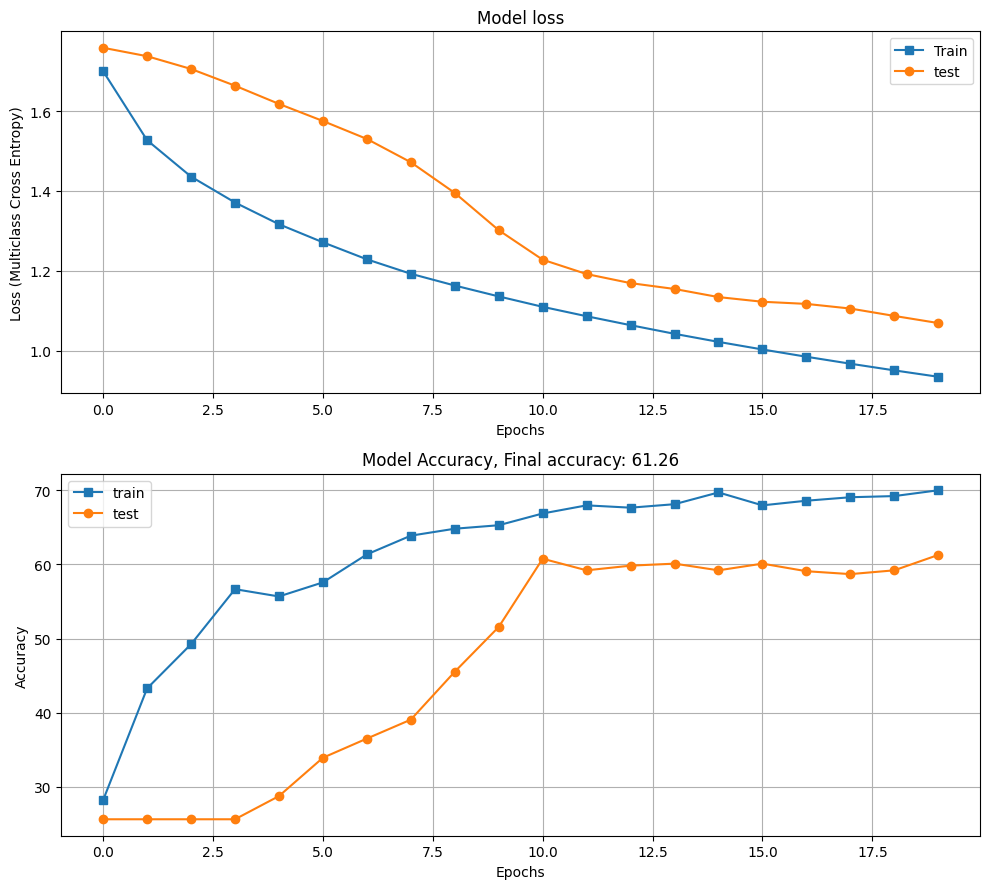

In [133]:
# display the accuracy of our model
fig, ax = plt.subplots(2, 1, figsize = (10, 9))

ax[0].plot(train_loss, "s-", label = "Train")
ax[0].plot(test_loss, "o-", label = "test")
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Loss (Multiclass Cross Entropy)")
ax[0].set_title("Model loss")
ax[0].legend()
ax[0].grid()

ax[1].plot(train_accuracy, "s-", label = "train")
ax[1].plot(test_accuracy, "o-", label = "test")
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Accuracy")
ax[1].set_title(f"Model Accuracy, Final accuracy: {test_accuracy[-1]:.2f}")
ax[1].legend()
ax[1].grid()


plt.tight_layout()
plt.show()

In [134]:
# extract a bact from the test set
X, y = next(iter(test_loader))

# move the data to GPU
X = X.to(device)
y = y.to(device)

# prediction and out convolution layers
yHat, feature_maps1, feature_maps2= network(X)
# check the shape of the two feature maps
print(feature_maps1.shape, feature_maps2.shape)

torch.Size([128, 12, 150, 150]) torch.Size([128, 20, 75, 75])


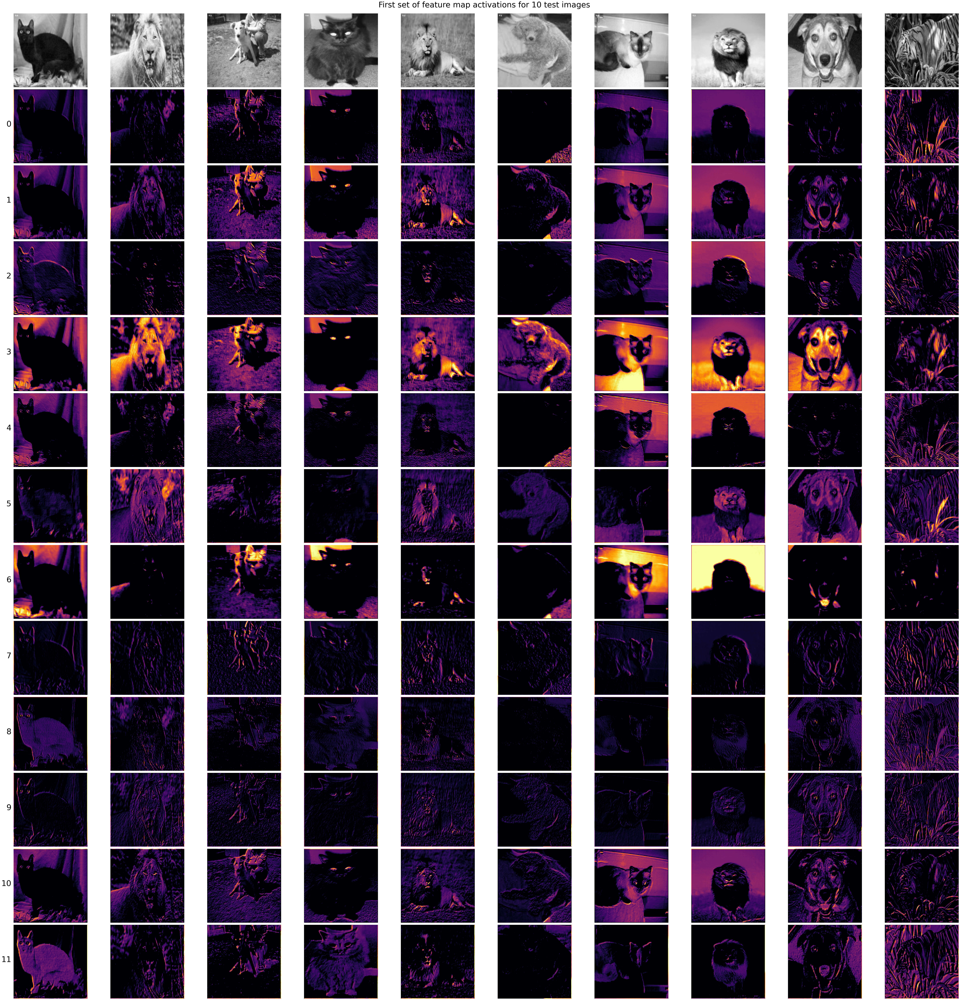

In [135]:
number_of_images = 10

fig,axs = plt.subplots(feature_maps1.shape[1] + 1, number_of_images, figsize=(70, 70))

for pici in range(number_of_images):

    # show the original picture
    img = X[pici, 0, :, :].detach().cpu()
    axs[0, pici].imshow(img, cmap="gray", vmin=0, vmax=1)
    axs[0, pici].axis('off')
    axs[0, pici].text(2,2,'T:%s'%int(y[pici].item()),ha='left',va='top',color='w',fontweight='bold')

    for feati in range(feature_maps1.shape[1]):
        # extract the feature map from this image
        img = feature_maps1[pici,feati,:,:].detach().cpu()
        axs[feati+1,pici].imshow(img,cmap='inferno',vmin=0,vmax=torch.max(img)*.9)
        axs[feati+1,pici].axis('off')
        axs[feati+1,pici].text(-5,feature_maps1.shape[2]/2,feati,ha='right', fontsize=40) if pici==0 else None

plt.tight_layout()
plt.suptitle(f'First set of feature map activations for {number_of_images} test images',x=.5,y=1.01, fontsize=40)

# save the plot
# plt.savefig('feature_maps1.png', dpi=300, bbox_inches='tight')
plt.show()